In [1]:
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.layers import Input, Conv2D, Conv2DTranspose, MaxPool2D, AvgPool2D, Activation, Concatenate, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.applications import EfficientNetB0, EfficientNetB4
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.metrics import Recall, Precision
import tensorflow.keras.backend as K
import tensorflow_addons as tfa
import random
import datetime
import numpy as np
import pandas as pd
import PIL
from PIL import ImageOps
import os
from pathlib import Path
from IPython.display import Image, display

In [2]:
#EfficientNetB4().summary()

In [3]:
np.random.seed(42)

In [4]:
tf.__version__

'2.3.0'

In [5]:
df = pd.read_csv('~/Desktop/freelancer_drone/data/class_dict_seg.csv')
num_classes = df.shape[0]

In [6]:
df.to_dict()

{'name': {0: 'unlabeled',
  1: 'paved-area',
  2: 'dirt',
  3: 'grass',
  4: 'gravel',
  5: 'water',
  6: 'rocks',
  7: 'pool',
  8: 'vegetation',
  9: 'roof',
  10: 'wall',
  11: 'window',
  12: 'door',
  13: 'fence',
  14: 'fence-pole',
  15: 'person',
  16: 'dog',
  17: 'car',
  18: 'bicycle',
  19: 'tree',
  20: 'bald-tree',
  21: 'ar-marker',
  22: 'obstacle',
  23: 'conflicting'},
 ' r': {0: 0,
  1: 128,
  2: 130,
  3: 0,
  4: 112,
  5: 28,
  6: 48,
  7: 0,
  8: 107,
  9: 70,
  10: 102,
  11: 254,
  12: 254,
  13: 190,
  14: 153,
  15: 255,
  16: 102,
  17: 9,
  18: 119,
  19: 51,
  20: 190,
  21: 112,
  22: 2,
  23: 255},
 ' g': {0: 0,
  1: 64,
  2: 76,
  3: 102,
  4: 103,
  5: 42,
  6: 41,
  7: 50,
  8: 142,
  9: 70,
  10: 102,
  11: 228,
  12: 148,
  13: 153,
  14: 153,
  15: 22,
  16: 51,
  17: 143,
  18: 11,
  19: 51,
  20: 250,
  21: 150,
  22: 135,
  23: 0},
 ' b': {0: 0,
  1: 128,
  2: 0,
  3: 0,
  4: 87,
  5: 168,
  6: 30,
  7: 89,
  8: 35,
  9: 70,
  10: 156,
  11: 12,


In [6]:
IMG_H = 416
IMG_W = 608
batch_size = 3

In [7]:
input_dir = 'data/dataset/semantic_drone_dataset/original_images'
target_dir = 'data/dataset/semantic_drone_dataset/label_images_semantic'
color_dir = 'data/RGB_color_image_masks/RGB_color_image_masks'

In [8]:
input_img_paths = sorted([i for i in Path(input_dir).glob('**/*.jpg')])
input_lbl_paths = sorted([i for i in Path(target_dir).glob('**/*.png')])
color_paths = sorted([i for i in Path(color_dir).glob('**/*.png')])

In [9]:
i_ = np.zeros((10,) + (255, 255) + (1, ), dtype='uint8')
img = load_img('data/dataset/semantic_drone_dataset/label_images_semantic/491.png', target_size=(255,255), color_mode='grayscale')

In [10]:
np.unique(np.expand_dims(img, 2))

array([ 1,  6,  8, 15, 22], dtype=uint8)

In [11]:
i_[0] = np.expand_dims(img, 2)

In [12]:
np.unique(i_[0])

array([ 1,  6,  8, 15, 22], dtype=uint8)

In [13]:
class CDG(tf.keras.utils.Sequence):
    def __init__(self, batch_size, img_size, input_image_path, target_image_path, num_classes):
        self.batch_size = batch_size
        self.img_size = img_size
        self.input_image_path = input_image_path
        self.target_image_path = target_image_path
        self.num_classes = num_classes
    
    def __len__(self):
        return len(self.target_image_path) // self.batch_size
    
    def __random_flip(self, x, y):
        rand = np.random.randint(0, 21)
        if rand % 3 == 0:
            x = tf.image.flip_left_right(x)
            y = tf.image.flip_left_right(y)

        return x, y
                    
    def __random_cont(self, x):
        x = tf.image.random_contrast(x, .1, .2)
        #display(tf.keras.preprocessing.image.array_to_img(x[0]))
        return x
    
    def __random_zoom(self, x, y):
        ow, oh = np.random.randint(0, 100), np.random.randint(0, 100)
        tw, th = np.random.randint(256/2, self.img_size[0]-ow), np.random.randint(256/2, self.img_size[0]-oh)
        x = tf.image.crop_to_bounding_box(x, oh, ow, th, tw)
        y = tf.image.crop_to_bounding_box(y, oh, ow, th, tw)
        
        x = tf.image.resize(x, [self.img_size[0], self.img_size[1]], method='nearest')
        y = tf.image.resize(y, [self.img_size[0], self.img_size[1]], method='nearest')
        
        return x, y
        
    def __rotate(self, x, y):
        deg = np.random.randint(0, 359)
        x = tfa.image.rotate(x, deg)
        y = tfa.image.rotate(y, deg)
        return x, y
        
    def __getitem__(self, idx):
        input_batch = self.input_image_path[idx*self.batch_size  : idx*self.batch_size + self.batch_size]
        target_batch = self.target_image_path[idx*self.batch_size : idx*self.batch_size + self.batch_size]
        
        x = np.zeros((self.batch_size,) + self.img_size + (3, ), dtype='float32')
        for j, path in enumerate(input_batch):
            img = load_img(path, target_size=self.img_size)
            #img = np.asarray(img) / 255
            img = np.asarray(img)
            x[j] = img
            
        
        y = np.zeros((self.batch_size,) + self.img_size + (1, ), dtype='uint8')
        for j, path in enumerate(target_batch):
            img = load_img(path, target_size=self.img_size, color_mode='grayscale')
            #img = np.asarray(img) / self.num_classes
            y[j] = np.expand_dims(img, 2)
        
        #x = self.__random_cont(x)
        x, y = self.__random_zoom(x, y)
        x, y  = self.__random_flip(x, y)
        x, y = self.__rotate(x, y)
              
        return x, y
    
    def on_epoch_end(self):
        zipped = list(zip(self.input_image_path, self.target_image_path))
        random.shuffle(zipped)
        self.input_image_path, self.target_image_path = zip(*zipped)
        
    

In [14]:
import random

In [15]:
random.seed(42)

In [16]:
l = [1, 2, 3, 4]
f = [1, 2, 3, 4]
z = list(zip(l, f))

In [17]:
random.shuffle(z)

In [18]:
l, f = zip(*z)

In [19]:
list(l)

[3, 2, 4, 1]

In [20]:
f

(3, 2, 4, 1)

In [21]:
def dice_coef(y_true, y_pred, smooth=1e-7):
    '''
    Dice coefficient for 24 categories. Ignores background pixel label 0
    Pass to model as metric during compile statement
    '''
    y_true_f = K.flatten(K.one_hot(K.cast(y_true, 'int32'), num_classes=23)[...,1:])
    y_pred_f = K.flatten(y_pred[...,1:])
    intersect = K.sum(y_true_f * y_pred_f, axis=-1)
    denom = K.sum(y_true_f + y_pred_f, axis=-1)
    return K.mean((2. * intersect / (denom + smooth)))

def dice_loss(y_true, y_pred):
    '''
    Dice loss to minimize. Pass to model as loss during compile statement
    '''
    return 1 - dice_coef(y_true, y_pred)


In [22]:
def conv_block(inputs, num_filters):
    x = Conv2D(num_filters, 3, padding='same')(inputs)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    x = Conv2D(num_filters, 3, padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    
    return x

In [23]:
def decoder(inputs, skip, num_filters):
    x = Conv2DTranspose(num_filters,(2, 2), strides=2, padding="same")(inputs)
    x = Concatenate()([x, skip])
    x = conv_block(x, num_filters)
    
    return x

In [24]:
def eff_unet(input_shape, num_classes):
    inputs = Input(shape=input_shape)
    
    enc = EfficientNetB4(include_top=False, weights="imagenet", input_tensor=inputs)
    s1 = enc.get_layer("input_1").output     
    s2 = enc.get_layer("block2a_expand_activation").output    
    s3 = enc.get_layer("block3a_expand_activation").output    
    s4 = enc.get_layer("block4a_expand_activation").output 
    
    bn = enc.get_layer("block6a_expand_activation").output

    
    db1 = decoder(bn, s4, 512)
    db2 = decoder(db1, s3, 256)
    db3 = decoder(db2, s2, 128)
    db4 = decoder(db3, s1, 64)
    
    
    outputs = Conv2D(num_classes, 3, padding='same', activation='softmax')(db4)
    
    model = Model(inputs, outputs)
    return model


In [25]:
len(input_img_paths)

400

In [26]:
x_train, y_train, c_train = input_img_paths[:int(.9*len(input_img_paths))], input_lbl_paths[:int(.9*len(input_img_paths))], color_paths[:int(.9*len(input_img_paths))]
x_val, y_val, c_val = input_img_paths[int(.9*len(input_img_paths)):], input_lbl_paths[int(.9*len(input_img_paths)):], color_paths[int(.9*len(input_img_paths)):] 

In [27]:
x_train[:3]

[PosixPath('data/dataset/semantic_drone_dataset/original_images/000.jpg'),
 PosixPath('data/dataset/semantic_drone_dataset/original_images/001.jpg'),
 PosixPath('data/dataset/semantic_drone_dataset/original_images/002.jpg')]

In [28]:
y_train[:3]

[PosixPath('data/dataset/semantic_drone_dataset/label_images_semantic/000.png'),
 PosixPath('data/dataset/semantic_drone_dataset/label_images_semantic/001.png'),
 PosixPath('data/dataset/semantic_drone_dataset/label_images_semantic/002.png')]

In [29]:
train_gen = CDG(batch_size, (IMG_H, IMG_W), x_train, y_train, num_classes)
val_gen = CDG(batch_size, (IMG_H, IMG_W), x_val, y_val, num_classes)

In [30]:
np.unique(train_gen[0][1])

/home/scutum/envs/data-science/lib/python3.8/site-packages/tensorflow_addons/image/transform_ops.py:142: UserWarning: fill_value is not supported and is always 0 for TensorFlow < 2.4.0.
  warnings.warn(


array([ 0,  1,  2,  3,  4,  8, 13, 14, 15, 19, 21, 22], dtype=uint8)

In [31]:
model_name = 'models/drone_segmentation_416X608_woscaling_100ep_effnetb4_aug_randomshuffle.h5'

In [32]:
input_shape = (IMG_H, IMG_W, 3)
model = eff_unet(input_shape, num_classes)
#opt = tf.keras.optimizers.Nadam(1e-3)
save_best = tf.keras.callbacks.ModelCheckpoint(model_name, monitor="val_loss", verbose=0, save_best_only=True)
#model.compile(optimizer=opt, loss='sparse_categorical_crossentropy')
model.compile(optimizer='rmsprop', loss='sparse_categorical_crossentropy', metrics=['sparse_categorical_accuracy'])
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [33]:
hist = model.fit(train_gen, epochs=100, validation_data=val_gen, callbacks=[tensorboard_callback, save_best])

Epoch 1/100
  1/120 [..............................] - ETA: 0s - loss: 3.3986 - sparse_categorical_accuracy: 0.0095WARNING:tensorflow:From /home/scutum/envs/data-science/lib/python3.8/site-packages/tensorflow/python/ops/summary_ops_v2.py:1277: stop (from tensorflow.python.eager.profiler) is deprecated and will be removed after 2020-07-01.
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
120/120 [==============================] - 148s 1s/step - loss: 1.3813 - sparse_categorical_accuracy: 0.6130 - val_loss: 1.4616 - val_sparse_categorical_accuracy: 0.6622
Epoch 2/100
120/120 [==============================] - 146s 1s/step - loss: 1.1191 - sparse_categorical_accuracy: 0.6683 - val_loss: 1.4233 - val_sparse_categorical_accuracy: 0.7026
Epoch 3/100
120/120 [==============================] - 146s 1s/step - loss: 1.0204 - sparse_categorical_accuracy: 0.6923 - val_loss: 0.9998 - val_sparse_categorical_accuracy: 0.7207
Epoch 4/100
120/120 [==============================] 

In [34]:
model = load_model(model_name)

In [35]:
preds = model.predict(val_gen)

In [36]:
preds.shape

(39, 416, 608, 24)

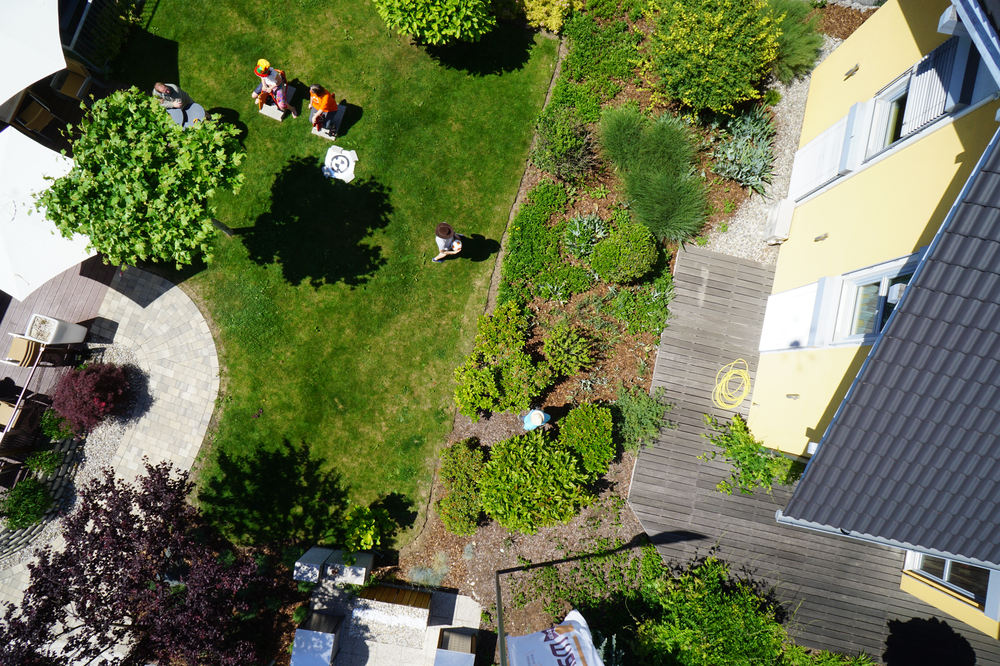

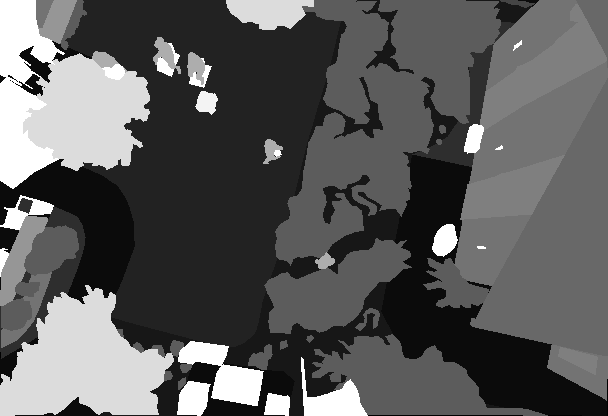

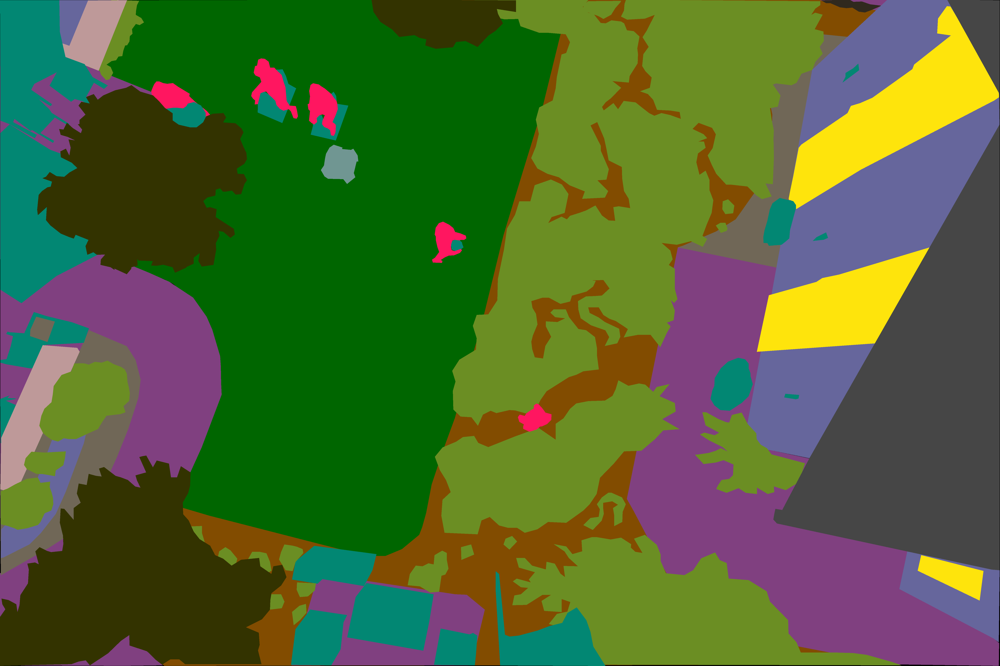

[ 0  1  2  3  4  5  6  8  9 10 11 13 15 19 22]
(416, 608)


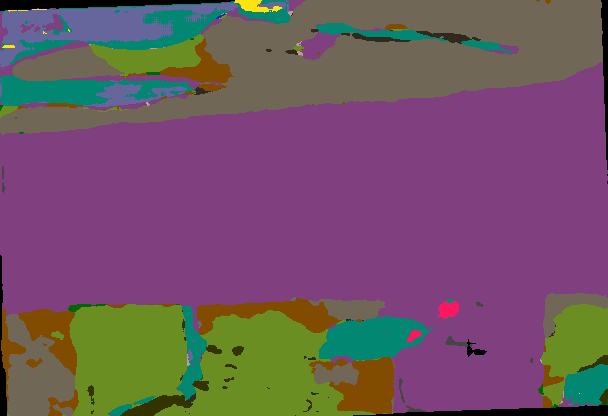

In [37]:
def display_mask(i):
    """Quick utility to display a model's prediction."""
    mask = np.argmax(preds[i], axis=-1)
    print(np.unique(mask))
    print(mask.shape)
    #mask = np.expand_dims(mask, axis=-1)
    #print(mask.shape)
    
    seg_img = np.zeros((IMG_H, IMG_W, 3))
    seg_img_gs = np.zeros((IMG_H, IMG_W, 3))
    
    for c in range(num_classes): 
        c_codes = [df[' r'][c],  df[' g'][c], df[' b'][c]]
        for i in range(3):
            seg_arr_c = mask[:, :] == c
            seg_img[:, :, i] += ((seg_arr_c)*(c_codes[i])).astype('uint8')
            
    for c in range(num_classes): 
        for i in range(3):
            seg_arr_c_gs = mask[:, :] == c
            seg_img_gs[:, :, i] += ((seg_arr_c_gs)*(c)).astype('uint8')
    
            
    #img = PIL.ImageOps.autocontrast(tf.keras.preprocessing.image.array_to_img(mask))
    img = tf.keras.preprocessing.image.array_to_img(seg_img)
    display(img)
    return seg_img_gs

# Display results for validation image #10
i = 0

# Display input image
display(Image(filename=x_val[i], width=IMG_W, height=IMG_H))

# Display ground-truth target mask
img = PIL.ImageOps.autocontrast(load_img(y_val[i], target_size=(IMG_H, IMG_W)))
display(img)

# Display color mask
display(Image(filename=c_val[i], width=IMG_W, height=IMG_H))

# Display mask predicted by our model
seg_img_gs = display_mask(i)  # Note that the model only sees inputs at 150x150.

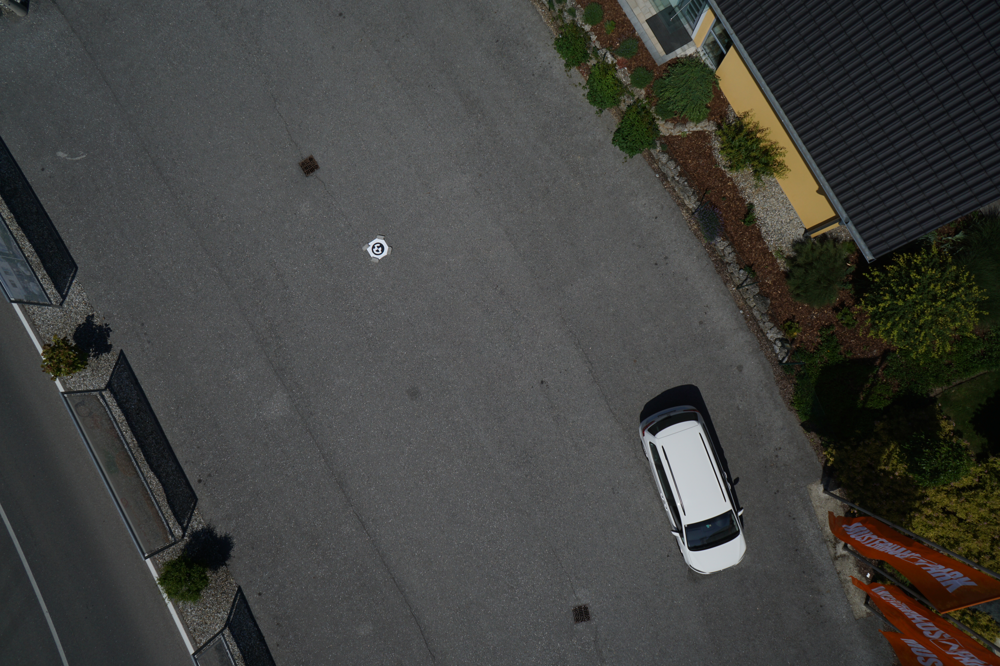

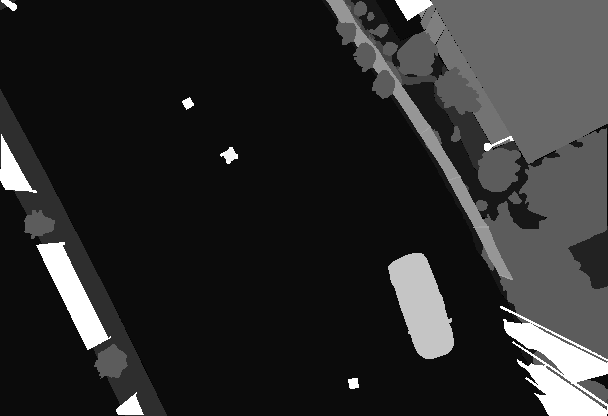

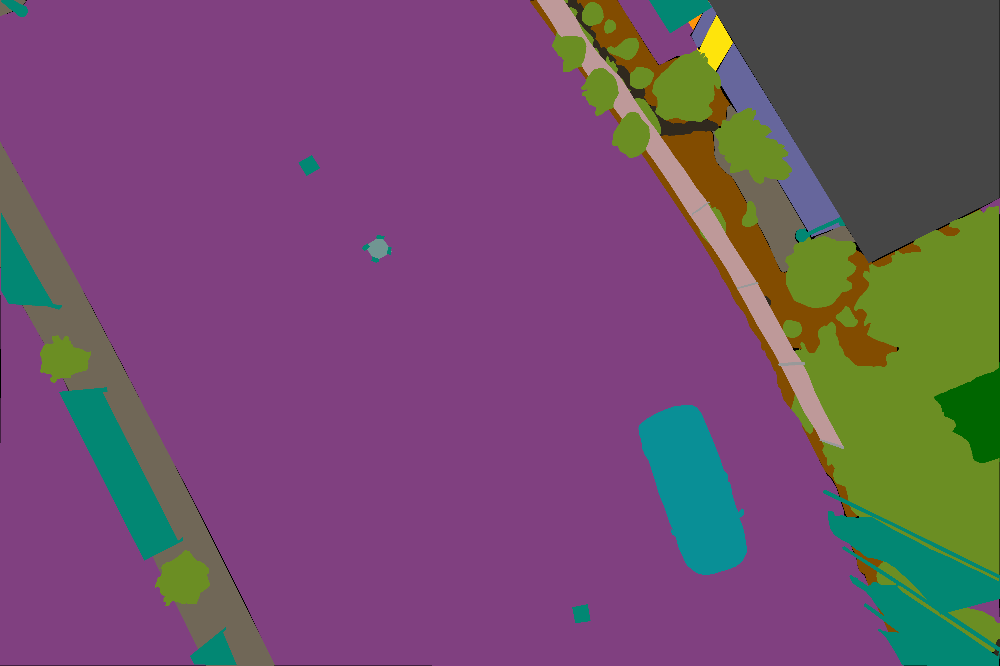

[ 0  1  2  3  4  5  6  8  9 10 11 13 17 19 21 22]
(416, 608)


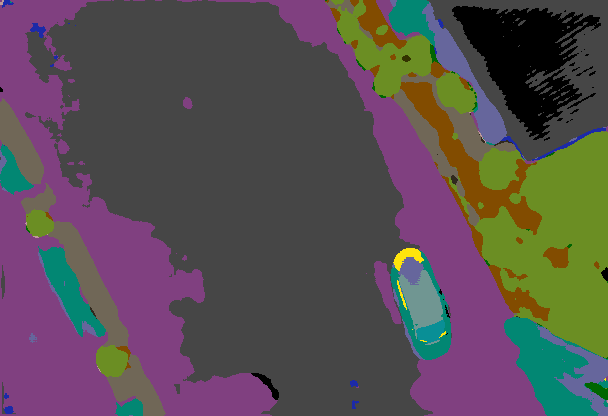

In [39]:
def display_single(pred):
    """Quick utility to display a model's prediction."""
    mask = np.argmax(pred[0], axis=-1)
    print(np.unique(mask))
    print(mask.shape)
    #mask = np.expand_dims(mask, axis=-1)
    #print(mask.shape)
    
    seg_img = np.zeros((IMG_H, IMG_W, 3))
    seg_img_gs = np.zeros((IMG_H, IMG_W, 3))
    
    for c in range(num_classes): 
        c_codes = [df[' r'][c],  df[' g'][c], df[' b'][c]]
        for i in range(3):
            seg_arr_c = mask[:, :] == c
            seg_img[:, :, i] += ((seg_arr_c)*(c_codes[i])).astype('uint8')
            
    for c in range(num_classes): 
        for i in range(3):
            seg_arr_c_gs = mask[:, :] == c
            seg_img_gs[:, :, i] += ((seg_arr_c_gs)*(c)).astype('uint8')
    
            
    #img = PIL.ImageOps.autocontrast(tf.keras.preprocessing.image.array_to_img(mask))
    img = tf.keras.preprocessing.image.array_to_img(seg_img)
    display(img)
    return seg_img_gs

# Display results for validation image #10
i = 8

# Display input image
display(Image(filename=x_train[i], width=IMG_W, height=IMG_H))

# Display ground-truth target mask
img = PIL.ImageOps.autocontrast(load_img(y_train[i], target_size=(IMG_H, IMG_W)))
display(img)

# Display color mask
display(Image(filename=c_train[i], width=IMG_W, height=IMG_H))

# Display mask predicted by our model

pred_img = load_img(x_train[i], target_size=(IMG_H, IMG_W))

pred_img = np.expand_dims(np.asarray(pred_img), 0)
pred = model.predict(pred_img)
seg_img_gs = display_single(pred) 

In [40]:
pred[0].shape

(416, 608, 24)

In [41]:
np.argmax(pred[0], axis=-1).shape

(416, 608)

In [42]:
m = tf.keras.metrics.MeanIoU(num_classes=24)

In [43]:
np.asarray(load_img(y_train[i], target_size=(IMG_H, IMG_W)))

array([[[ 4,  4,  4],
        [22, 22, 22],
        [22, 22, 22],
        ...,
        [ 9,  9,  9],
        [ 9,  9,  9],
        [ 9,  9,  9]],

       [[ 4,  4,  4],
        [22, 22, 22],
        [22, 22, 22],
        ...,
        [ 9,  9,  9],
        [ 9,  9,  9],
        [ 9,  9,  9]],

       [[ 4,  4,  4],
        [ 4,  4,  4],
        [22, 22, 22],
        ...,
        [ 9,  9,  9],
        [ 9,  9,  9],
        [ 9,  9,  9]],

       ...,

       [[ 1,  1,  1],
        [ 1,  1,  1],
        [ 1,  1,  1],
        ...,
        [22, 22, 22],
        [22, 22, 22],
        [22, 22, 22]],

       [[ 1,  1,  1],
        [ 1,  1,  1],
        [ 1,  1,  1],
        ...,
        [22, 22, 22],
        [22, 22, 22],
        [ 0,  0,  0]],

       [[ 1,  1,  1],
        [ 1,  1,  1],
        [ 1,  1,  1],
        ...,
        [22, 22, 22],
        [22, 22, 22],
        [ 0,  0,  0]]], dtype=uint8)

In [44]:
seg_img_gs

array([[[ 1.,  1.,  1.],
        [ 1.,  1.,  1.],
        [13., 13., 13.],
        ...,
        [ 9.,  9.,  9.],
        [ 9.,  9.,  9.],
        [ 9.,  9.,  9.]],

       [[ 1.,  1.,  1.],
        [ 1.,  1.,  1.],
        [13., 13., 13.],
        ...,
        [ 9.,  9.,  9.],
        [ 9.,  9.,  9.],
        [ 9.,  9.,  9.]],

       [[13., 13., 13.],
        [13., 13., 13.],
        [13., 13., 13.],
        ...,
        [ 9.,  9.,  9.],
        [ 9.,  9.,  9.],
        [ 9.,  9.,  9.]],

       ...,

       [[ 1.,  1.,  1.],
        [ 1.,  1.,  1.],
        [ 9.,  9.,  9.],
        ...,
        [10., 10., 10.],
        [10., 10., 10.],
        [10., 10., 10.]],

       [[ 1.,  1.,  1.],
        [ 1.,  1.,  1.],
        [ 1.,  1.,  1.],
        ...,
        [10., 10., 10.],
        [10., 10., 10.],
        [10., 10., 10.]],

       [[ 1.,  1.,  1.],
        [ 1.,  1.,  1.],
        [ 1.,  1.,  1.],
        ...,
        [10., 10., 10.],
        [10., 10., 10.],
        [10., 10., 10.]]

In [45]:
m.update_state(np.asarray(load_img(y_train[i], target_size=(IMG_H, IMG_W))), seg_img_gs)

<tf.Variable 'UnreadVariable' shape=(24, 24) dtype=float64, numpy=
array([[0.00000e+00, 2.19000e+02, 5.40000e+01, 0.00000e+00, 1.08000e+02,
        1.35000e+02, 0.00000e+00, 0.00000e+00, 3.06000e+02, 6.30000e+01,
        1.71000e+02, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 5.70000e+01, 0.00000e+00],
       [7.41000e+02, 1.90140e+05, 1.29000e+02, 1.80000e+01, 9.00000e+02,
        8.40000e+02, 0.00000e+00, 0.00000e+00, 1.02000e+02, 3.09807e+05,
        1.52100e+03, 4.23000e+02, 0.00000e+00, 2.10000e+01, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        0.00000e+00, 0.00000e+00, 3.75900e+03, 0.00000e+00],
       [0.00000e+00, 1.06200e+03, 1.59510e+04, 1.17000e+02, 9.15000e+02,
        5.70000e+01, 3.00000e+00, 0.00000e+00, 1.03200e+03, 0.00000e+00,
        9.00000e+01, 0.00000e+00, 0.00000e+00, 0.00000e+00, 0.00000e+00,
        

In [46]:
m.result().numpy()

0.18562059